In [1]:
# ************************************************************************* #
#     Author:   Pawel Rosikiewicz                                           #       
#     Copyrith: IT IS NOT ALLOWED TO COPY OR TO DISTRIBUTE                  #
#               these file without written                                  #
#               persmission of the Author                                   #
#     Contact:  prosikiewicz@gmail.com                                      #
#                                                                           #
# ************************************************************************* #

# Config

# basedir
basedir = '/Users/pawel/Desktop/Activities/005__COURSES/000__EPFLext_ADSML/Module 4 __ Project/solution'

# project config
project_name = "Pawel_Rosikiewicz_EPFLext_Project4"
dataset_name = "swissroads" # its the same datasets as with swissroad, but train and valid datsets are stored together, 
subset_names = ["train", "valid", "test"]
class_colors = {          "car": "orange",
                          "van": "steelblue",
                          "truck": "red",
                          "bike": "forestgreen",
                          "motorcycle" : "purple",
                           "other": "dimgrey"}

# task config
task_name = "cnn" # tranfer learning ussing 1 or 2 layed NN, and features extracted wiht tf hub
module_name = "raw_images" # later on there is a second module with UNIT_TEST for each model, 
train_subset_names=["train"] # one names, str, !
valid_subset_names=["valid"]
test_subset_names=["test"] 

In [2]:
import os # allow changing, and navigating files and folders, 
import sys
import re # module to use regular expressions, 
import glob # lists names in folders that match Unix shell patterns
import random # functions that use and generate random numbers

import pickle
import warnings
import numpy as np # support for multi-dimensional arrays and matrices
import pandas as pd # library for data manipulation and analysis
import seaborn as sns # advance plots, for statistics, 
import matplotlib as mpl # to get some basif functions, heping with plot mnaking 
import matplotlib.pyplot as plt # for making plots, 

from PIL import Image, ImageDraw
from IPython.display import display
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import ParameterGrid
from sklearn.model_selection import train_test_split
from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import ParameterGrid
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import scale
from sklearn.metrics import accuracy_score
import graphviz # allows visualizing decision tree

import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import backend as K # used for housekeeping of tf models, 
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.decomposition import PCA
from tensorflow.keras import Sequential
from tensorflow.keras import activations
from tensorflow.keras import initializers
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras import optimizers
from tensorflow.keras import losses
from tensorflow.keras import metrics
from tensorflow.keras import Sequential, activations, initializers
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
from sklearn.utils import class_weight

In [3]:
os.chdir(basedir)
sys.path.append(basedir)

# my tools, loaded only form basedir, 
from src.utils.data_loaders import load_encoded_imgbatch_using_logfile, load_raw_img_batch, load_raw_img_batch_with_custom_datagen, cnn_data_loader
from src.utils.example_plots_after_clustering import plot_img_examples, create_spaces_between_img_clusters, plot_img_examples_from_dendrogram
from src.utils.annotated_pie_charts import annotated_pie_chart_with_class_and_group, prepare_img_classname_and_groupname
from src.utils.tools_for_plots import create_class_colors_dict
from src.utils.feature_extraction_tools import encode_images, create_augmented_images
from src.utils.logreg_tools import my_logredCV, plot_examples_with_predictions_and_proba, plot_examples_with_predictions_and_proba_gamma
from src.utils.random_forest import random_forest_grid_search, plot_random_tree_summary_andor_table
from src.utils.model_summary_plots import plot_grid_acc_and_return_summary_df, visual_model_summary
from src.utils.SVM_tools import SVM_grid_search, plot_grid_acc_and_return_summary_df
from src.utils.tools_for_plots import create_class_colors_dict
from src.utils.model_summary_plots import plot_grid_acc_and_return_summary_df, visual_model_summary, model_gridsearch_summary_plots
from src.utils.knn_tools import knn_grid_search
from src.utils.dense_networks_tools import create_keras_one_layer_dense_model, create_keras_two_layer_dense_model, denseNN_grid_search, plot_NN_loss_acc
from src.utils.example_plots import plot_example_images_with_datagenerator
from src.utils.cnn_tools import plot_NN_loss_acc, create_convNN, cnn_gridSearch
from src.utils.cnn_augmented_images_tools import plot_NN_loss_acc, cnn_model_for_unit_test, basic_cnn_model_with_two_layers, basic_cnn_model_with_two_layers
from src.utils.cnn_augmented_images_tools import cnn_gridSearch_customDataLoader
# one of my functions was generating warnign, on copies, despite using proper syntax, 
warnings.filterwarnings("ignore")

# To avoid restaring the kernel with keras, preffered solution; use conda install nomkl
os.environ['KMP_DUPLICATE_LIB_OK']='True'

In [4]:
PATH_raw = os.path.join(basedir, "data/raw", dataset_name)
PATH_encoded = os.path.join(basedir, "data/interim", dataset_name)
PATH_results = os.path.join(basedir, "data/results", f"{dataset_name}_{task_name}")

# create new direcory for task results, 
try: 
    os.mkdir(PATH_results)
    try:
        os.chdir(PATH_results)
        print(f"PATH_results was created: {PATH_results}")
    except:
        print(f"ERROR: PATH_results: {PATH_results} was not created correctly")
except: 
    print(f"PATH_results: {PATH_results} already exists")

PATH_results: /Users/pawel/Desktop/Activities/005__COURSES/000__EPFLext_ADSML/Module 4 __ Project/solution/data/results/swissroads_cnn already exists


# Test different method for image augmentation

Found 280 images belonging to 6 classes.


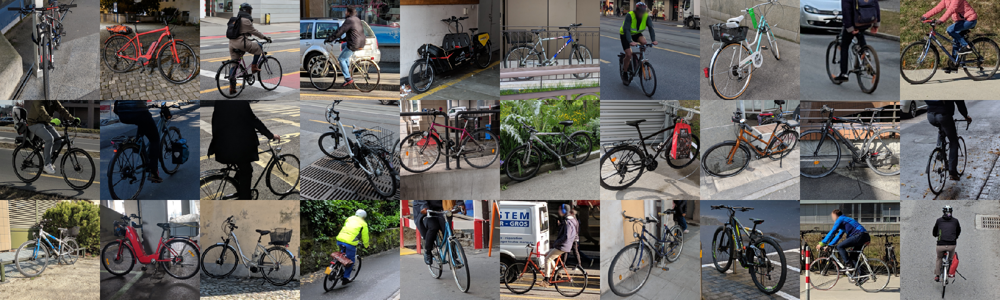

In [5]:
# set image size for plotting examples, 
img_size=(224, 224) # just for test, 

# .. create data generator,
datagen = ImageDataGenerator(rescale=1/255)  

# .. create iterator,
datagen_iter = datagen.flow_from_directory(
                        os.path.join(PATH_raw, train_subset_names[0]), 
                        batch_size=10, 
                        target_size=img_size,
                        shuffle=False
                    )

plot_example_images_with_datagenerator(
            generator=datagen_iter,
            n_batches=3,
            image_dim=img_size

        )


# grid search over cnn networks with different parameters, 

raw_images//0//1of9 --- 2020-11-22 01:50:43.125759
grid analysis
Found 280 images belonging to 6 classes.
Found 280 images belonging to 6 classes.
ADDING batch: train * 1, batch_arr: (280, 46, 46, 3), labels: (280, 7)
------------->>>: final batch_arr: (280, 46, 46, 3), labels: (280, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 139 images belonging to 6 classes.
Found 139 images belonging to 6 classes.
ADDING batch: valid * 1, batch_arr: (139, 46, 46, 3), labels: (139, 7)
------------->>>: final batch_arr: (139, 46, 46, 3), labels: (139, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 50 images belonging to 6 classes.
Found 50 images belonging to 6 classes.
ADDING batch: test * 1, batch_arr: (50, 46, 46, 3), labels: (50, 7)
------------->>>: final batch_arr: (50, 46, 46, 3), labels: (50, 7)
.. FOLLOWIING DATASETS WERE LOADED:
train: X: (280, 46, 46,

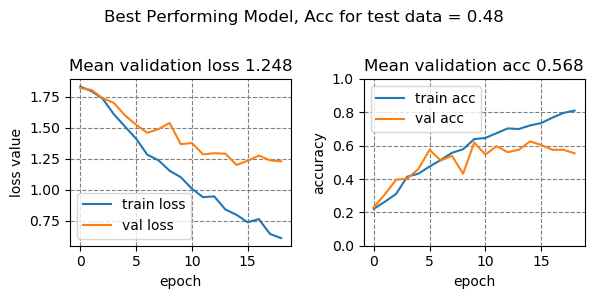

Found 50 images belonging to 6 classes.


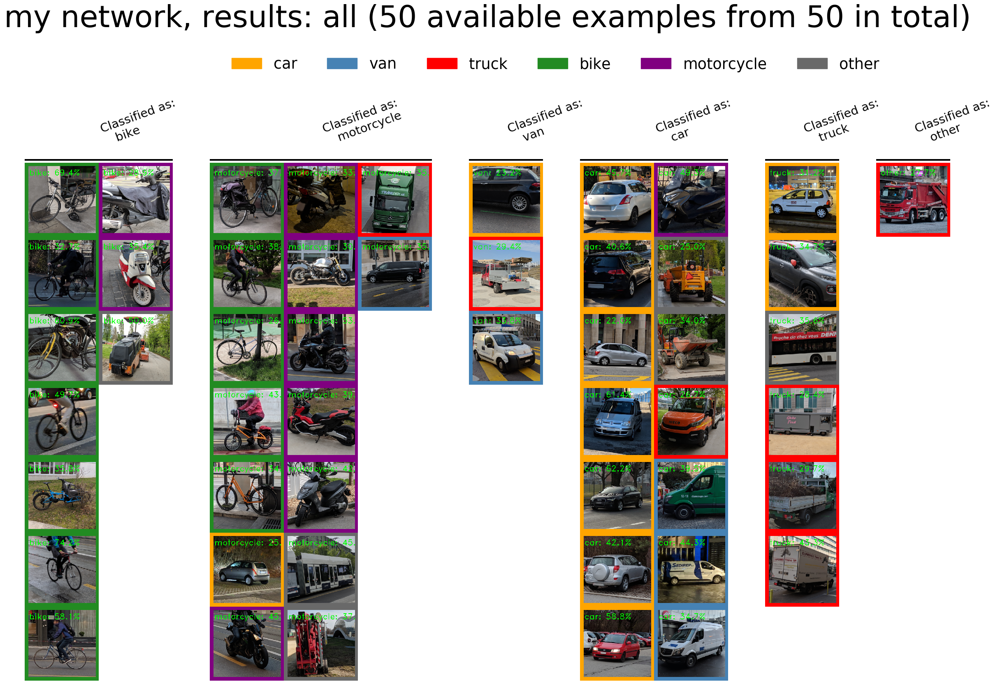

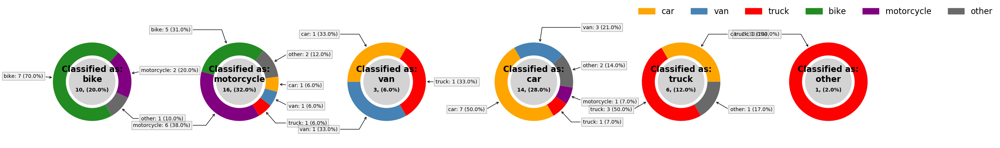

raw_images//0//2of9 --- 2020-11-22 01:50:57.170978
.Found 280 images belonging to 6 classes.
Found 280 images belonging to 6 classes.
ADDING batch: train * 1, batch_arr: (280, 46, 46, 3), labels: (280, 7)
------------->>>: final batch_arr: (280, 46, 46, 3), labels: (280, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 139 images belonging to 6 classes.
Found 139 images belonging to 6 classes.
ADDING batch: valid * 1, batch_arr: (139, 46, 46, 3), labels: (139, 7)
------------->>>: final batch_arr: (139, 46, 46, 3), labels: (139, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 50 images belonging to 6 classes.
Found 50 images belonging to 6 classes.
ADDING batch: test * 1, batch_arr: (50, 46, 46, 3), labels: (50, 7)
------------->>>: final batch_arr: (50, 46, 46, 3), labels: (50, 7)
.. FOLLOWIING DATASETS WERE LOADED:
train: X: (280, 46, 46, 3), y: (280,

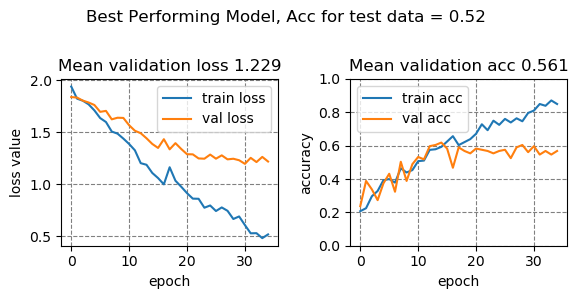

Found 50 images belonging to 6 classes.


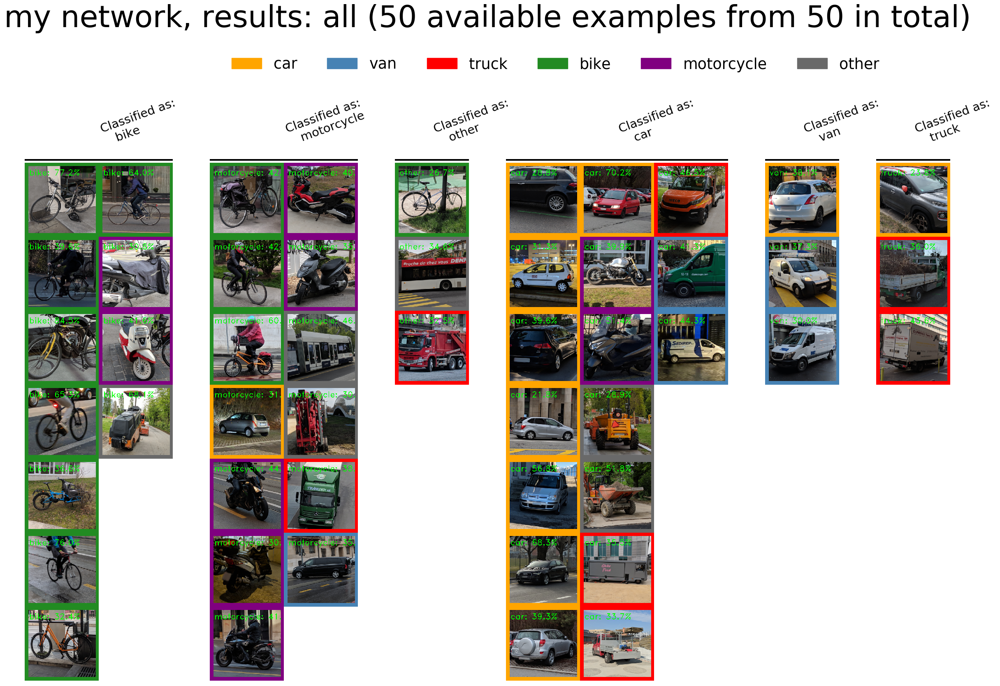

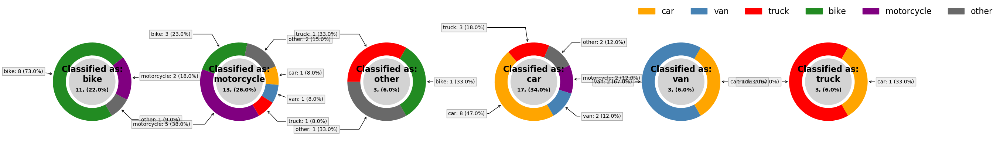

raw_images//0//3of9 --- 2020-11-22 01:51:14.237748
.Found 280 images belonging to 6 classes.
Found 280 images belonging to 6 classes.
ADDING batch: train * 1, batch_arr: (280, 46, 46, 3), labels: (280, 7)
------------->>>: final batch_arr: (280, 46, 46, 3), labels: (280, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 139 images belonging to 6 classes.
Found 139 images belonging to 6 classes.
ADDING batch: valid * 1, batch_arr: (139, 46, 46, 3), labels: (139, 7)
------------->>>: final batch_arr: (139, 46, 46, 3), labels: (139, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 50 images belonging to 6 classes.
Found 50 images belonging to 6 classes.
ADDING batch: test * 1, batch_arr: (50, 46, 46, 3), labels: (50, 7)
------------->>>: final batch_arr: (50, 46, 46, 3), labels: (50, 7)
.. FOLLOWIING DATASETS WERE LOADED:
train: X: (280, 46, 46, 3), y: (280,

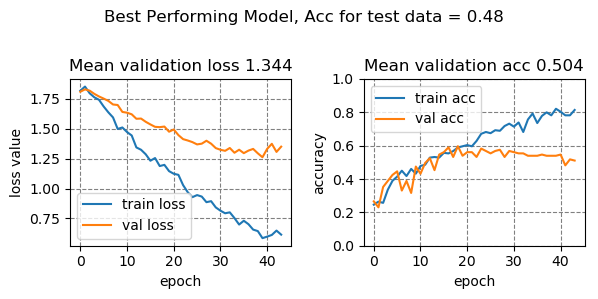

Found 50 images belonging to 6 classes.


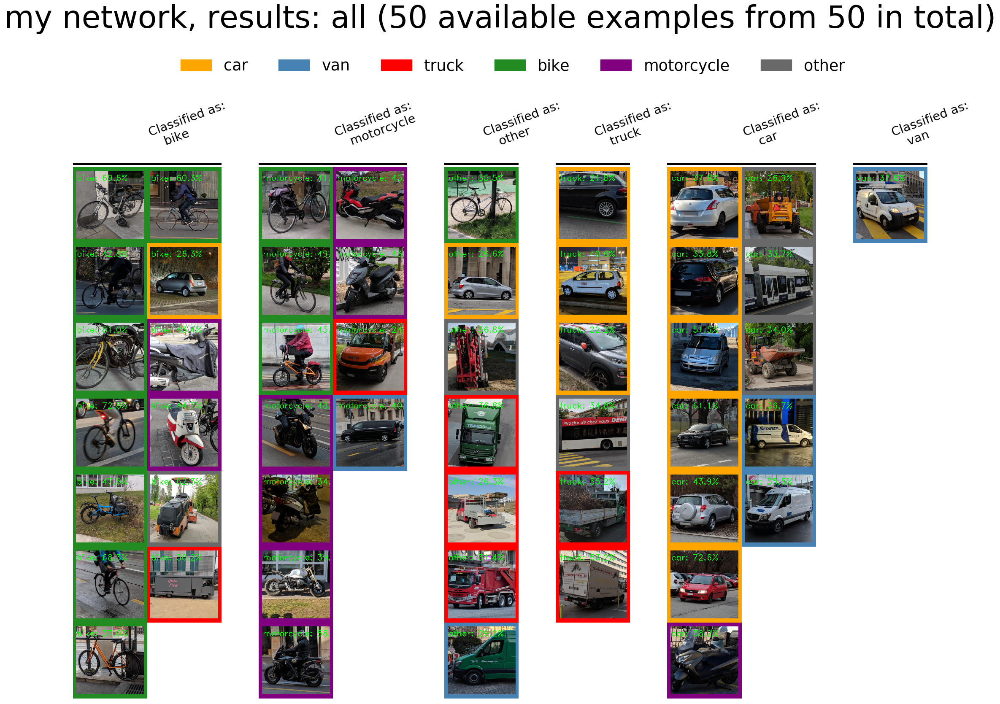

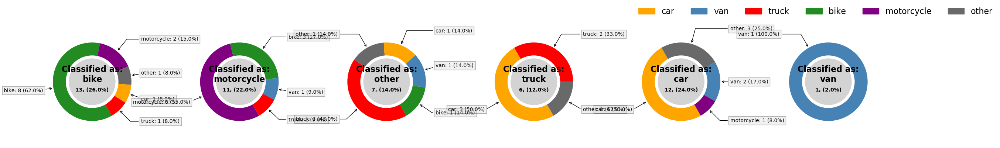

raw_images//0//4of9 --- 2020-11-22 01:51:33.214407
.Found 280 images belonging to 6 classes.
Found 280 images belonging to 6 classes.
ADDING batch: train * 1, batch_arr: (280, 96, 96, 3), labels: (280, 7)
------------->>>: final batch_arr: (280, 96, 96, 3), labels: (280, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 139 images belonging to 6 classes.
Found 139 images belonging to 6 classes.
ADDING batch: valid * 1, batch_arr: (139, 96, 96, 3), labels: (139, 7)
------------->>>: final batch_arr: (139, 96, 96, 3), labels: (139, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 50 images belonging to 6 classes.
Found 50 images belonging to 6 classes.
ADDING batch: test * 1, batch_arr: (50, 96, 96, 3), labels: (50, 7)
------------->>>: final batch_arr: (50, 96, 96, 3), labels: (50, 7)
.. FOLLOWIING DATASETS WERE LOADED:
train: X: (280, 96, 96, 3), y: (280,

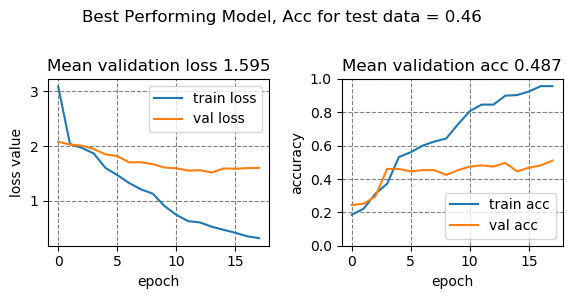

Found 50 images belonging to 6 classes.


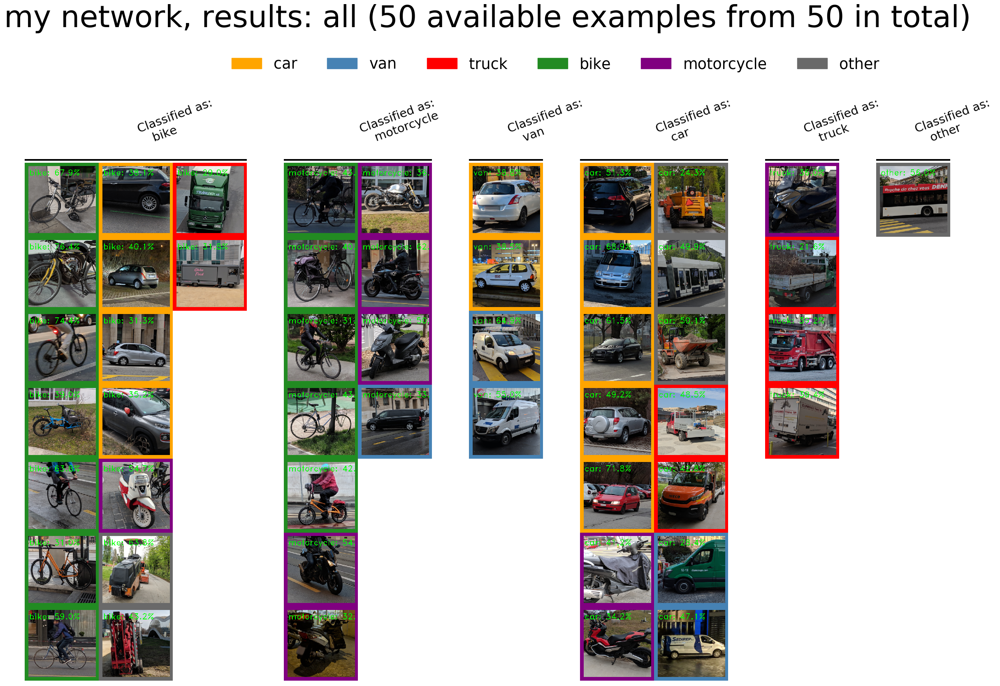

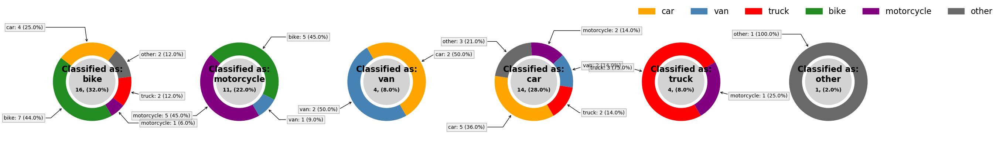

raw_images//0//5of9 --- 2020-11-22 01:52:08.970575
.Found 280 images belonging to 6 classes.
Found 280 images belonging to 6 classes.
ADDING batch: train * 1, batch_arr: (280, 96, 96, 3), labels: (280, 7)
------------->>>: final batch_arr: (280, 96, 96, 3), labels: (280, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 139 images belonging to 6 classes.
Found 139 images belonging to 6 classes.
ADDING batch: valid * 1, batch_arr: (139, 96, 96, 3), labels: (139, 7)
------------->>>: final batch_arr: (139, 96, 96, 3), labels: (139, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 50 images belonging to 6 classes.
Found 50 images belonging to 6 classes.
ADDING batch: test * 1, batch_arr: (50, 96, 96, 3), labels: (50, 7)
------------->>>: final batch_arr: (50, 96, 96, 3), labels: (50, 7)
.. FOLLOWIING DATASETS WERE LOADED:
train: X: (280, 96, 96, 3), y: (280,

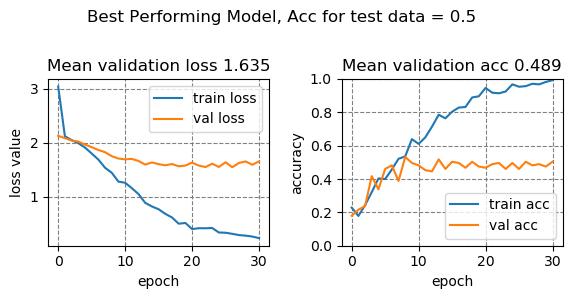

Found 50 images belonging to 6 classes.


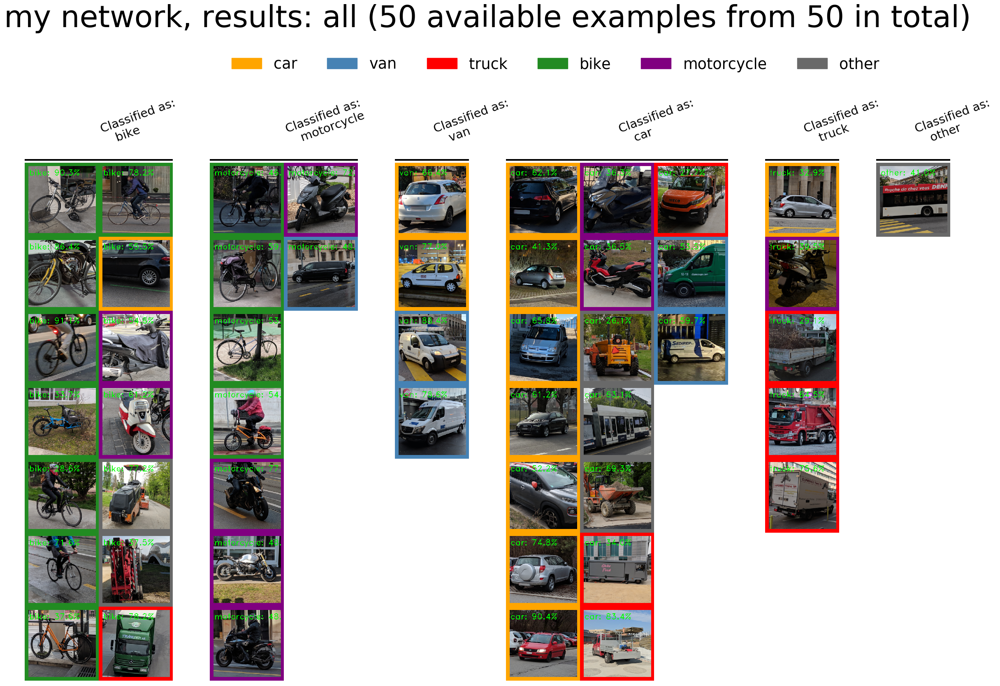

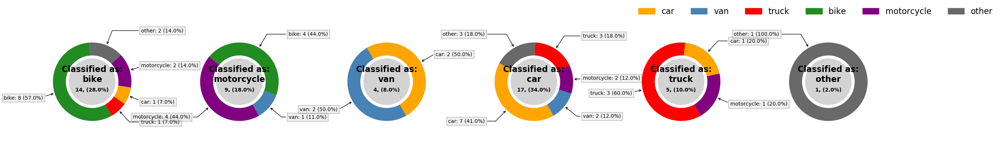

raw_images//0//6of9 --- 2020-11-22 01:53:00.982733
.Found 280 images belonging to 6 classes.
Found 280 images belonging to 6 classes.
ADDING batch: train * 1, batch_arr: (280, 96, 96, 3), labels: (280, 7)
------------->>>: final batch_arr: (280, 96, 96, 3), labels: (280, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 139 images belonging to 6 classes.
Found 139 images belonging to 6 classes.
ADDING batch: valid * 1, batch_arr: (139, 96, 96, 3), labels: (139, 7)
------------->>>: final batch_arr: (139, 96, 96, 3), labels: (139, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 50 images belonging to 6 classes.
Found 50 images belonging to 6 classes.
ADDING batch: test * 1, batch_arr: (50, 96, 96, 3), labels: (50, 7)
------------->>>: final batch_arr: (50, 96, 96, 3), labels: (50, 7)
.. FOLLOWIING DATASETS WERE LOADED:
train: X: (280, 96, 96, 3), y: (280,

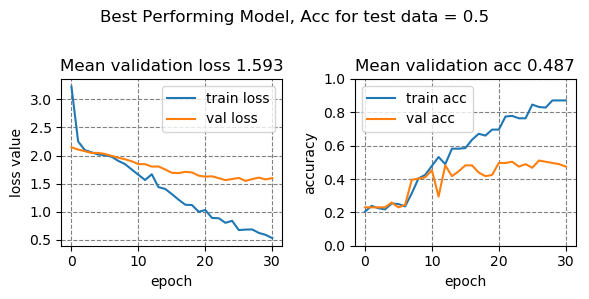

Found 50 images belonging to 6 classes.


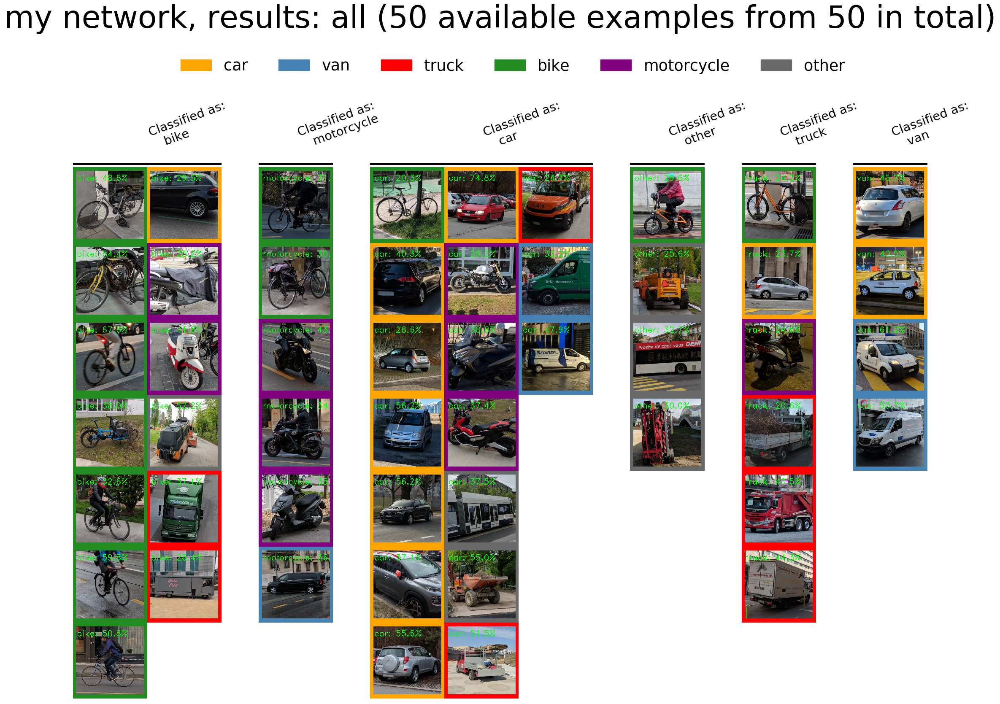

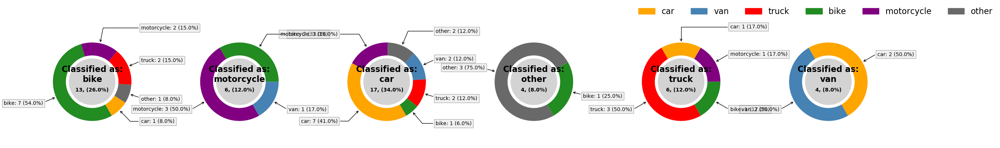

raw_images//0//7of9 --- 2020-11-22 01:53:52.840333
.Found 280 images belonging to 6 classes.
Found 280 images belonging to 6 classes.
ADDING batch: train * 1, batch_arr: (280, 224, 224, 3), labels: (280, 7)
------------->>>: final batch_arr: (280, 224, 224, 3), labels: (280, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 139 images belonging to 6 classes.
Found 139 images belonging to 6 classes.
ADDING batch: valid * 1, batch_arr: (139, 224, 224, 3), labels: (139, 7)
------------->>>: final batch_arr: (139, 224, 224, 3), labels: (139, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 50 images belonging to 6 classes.
Found 50 images belonging to 6 classes.
ADDING batch: test * 1, batch_arr: (50, 224, 224, 3), labels: (50, 7)
------------->>>: final batch_arr: (50, 224, 224, 3), labels: (50, 7)
.. FOLLOWIING DATASETS WERE LOADED:
train: X: (280, 224, 224

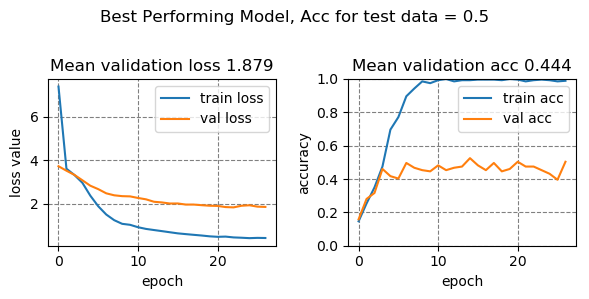

Found 50 images belonging to 6 classes.


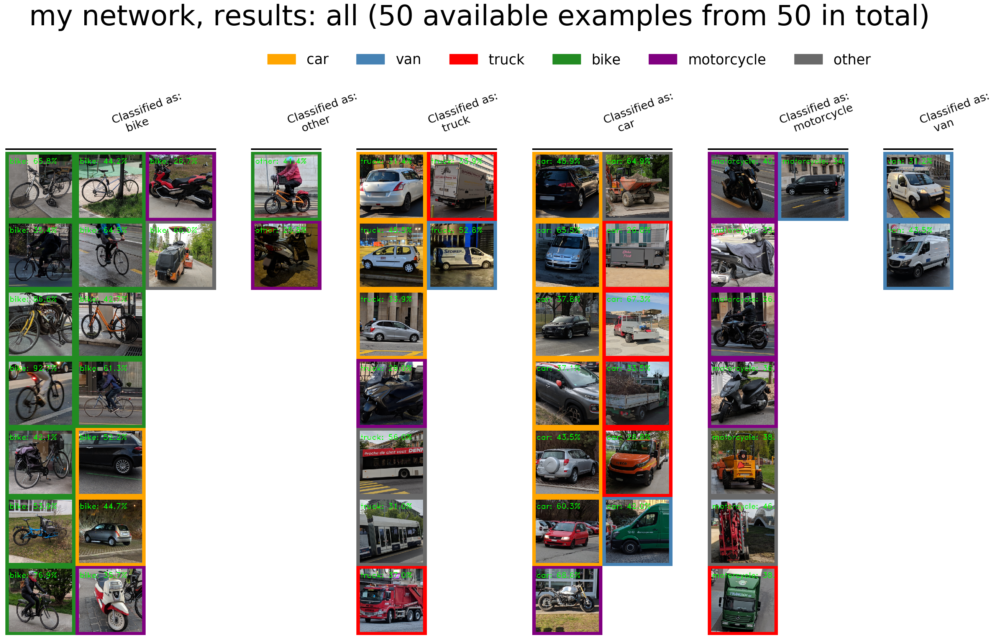

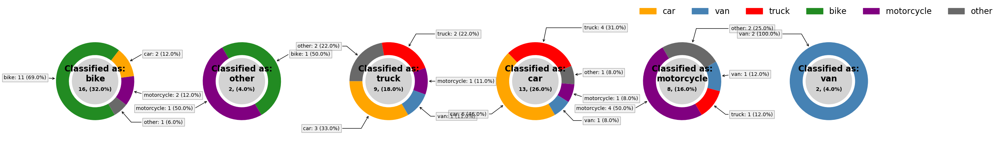

raw_images//0//8of9 --- 2020-11-22 01:58:28.047995
.Found 280 images belonging to 6 classes.
Found 280 images belonging to 6 classes.
ADDING batch: train * 1, batch_arr: (280, 224, 224, 3), labels: (280, 7)
------------->>>: final batch_arr: (280, 224, 224, 3), labels: (280, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 139 images belonging to 6 classes.
Found 139 images belonging to 6 classes.
ADDING batch: valid * 1, batch_arr: (139, 224, 224, 3), labels: (139, 7)
------------->>>: final batch_arr: (139, 224, 224, 3), labels: (139, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 50 images belonging to 6 classes.
Found 50 images belonging to 6 classes.
ADDING batch: test * 1, batch_arr: (50, 224, 224, 3), labels: (50, 7)
------------->>>: final batch_arr: (50, 224, 224, 3), labels: (50, 7)
.. FOLLOWIING DATASETS WERE LOADED:
train: X: (280, 224, 224

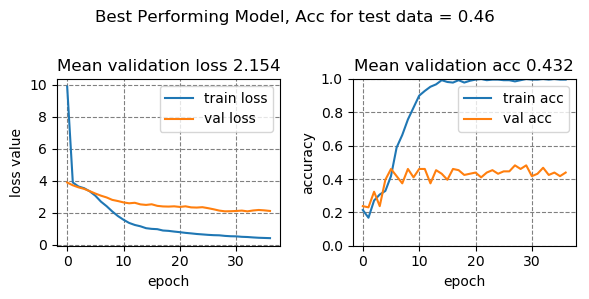

Found 50 images belonging to 6 classes.


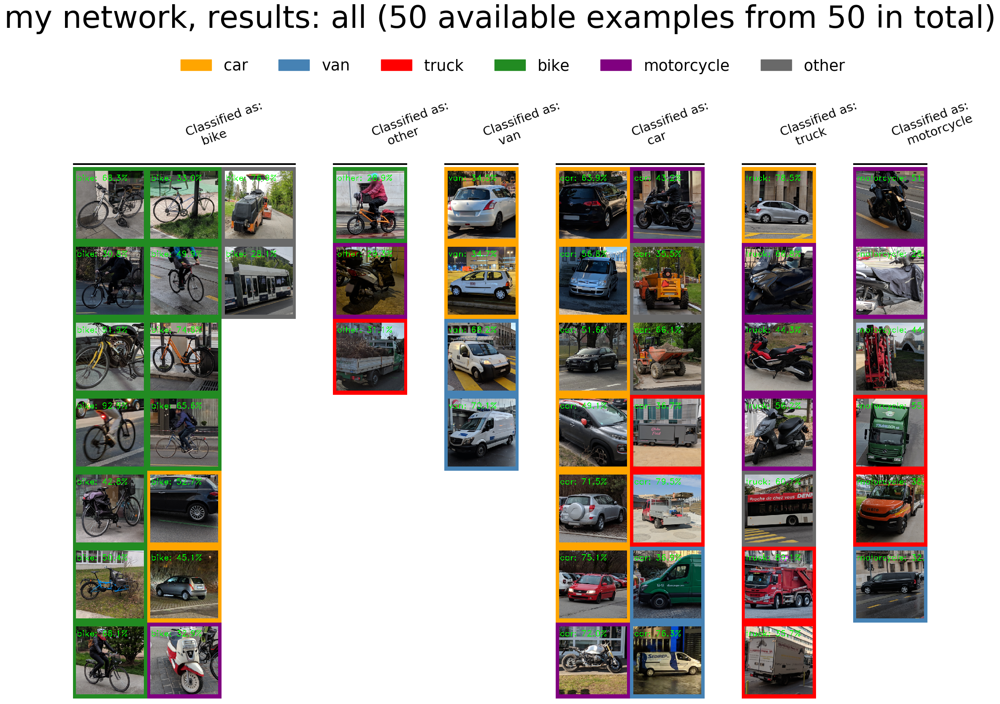

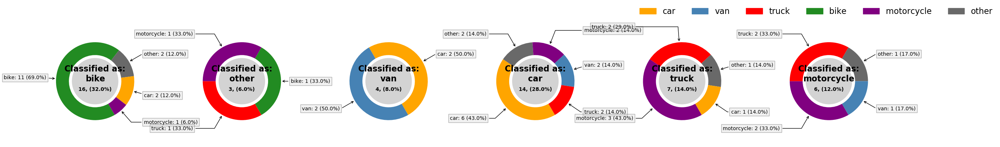

raw_images//0//9of9 --- 2020-11-22 02:03:40.964463
final combination
Found 280 images belonging to 6 classes.
Found 280 images belonging to 6 classes.
ADDING batch: train * 1, batch_arr: (280, 224, 224, 3), labels: (280, 7)
------------->>>: final batch_arr: (280, 224, 224, 3), labels: (280, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 139 images belonging to 6 classes.
Found 139 images belonging to 6 classes.
ADDING batch: valid * 1, batch_arr: (139, 224, 224, 3), labels: (139, 7)
------------->>>: final batch_arr: (139, 224, 224, 3), labels: (139, 7)
images from all batches and subsets were shiffled, you may reorganize them again using data in data_labels
Found 50 images belonging to 6 classes.
Found 50 images belonging to 6 classes.
ADDING batch: test * 1, batch_arr: (50, 224, 224, 3), labels: (50, 7)
------------->>>: final batch_arr: (50, 224, 224, 3), labels: (50, 7)
.. FOLLOWIING DATASETS WERE LOADED:
train: 

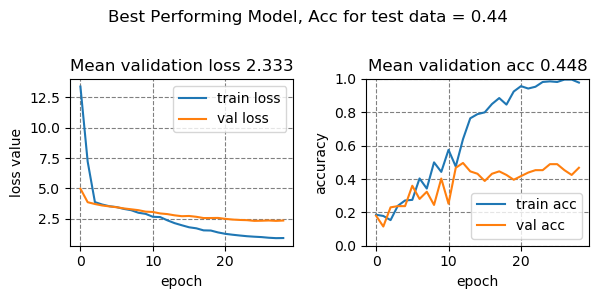

Found 50 images belonging to 6 classes.


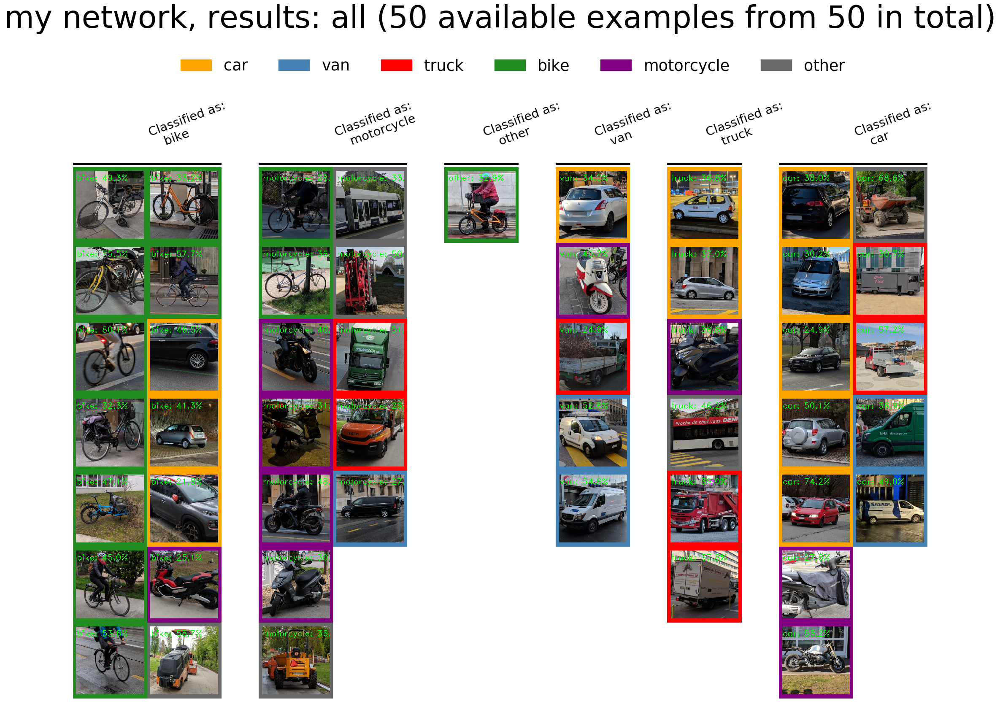

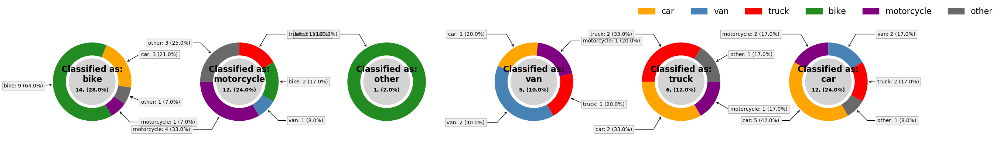

DONE ...


In [9]:

# ...................................................................................................................................................
# Configs for grid search,


# .. how to load and prepare the data, 
data_loader_params = {
    "img_size": None, # from main params, 
    "train_test_split__train_size": 0.7, # used only if valid_subset_names==None, otherwise I usse the test and valid datassets prepared before, 
    "img_generator":{
        "n_next_datagen": 1, # 20x augmented variants is made form each image, 
        "shuffle_all": True,  # images are mixed between batches,  
        "ImageDataGenerator_kwargs": None, 
        }
    }

# models applied,
model_params_1 = {
    "optimizer": "Adam", 
    "dense_one__units" : 360,    # unit nr in the first dense layer, 
    "EarlyStopping__patience": 4,
    "fit__batch_size": 32,
    "fit__epochs": 100,
    "fit__shuffle": True}
model_params_2 = {
    "optimizer": "Adam", 
    "dense_one__units" : 360,    # unit nr in the first dense layer, 
    "EarlyStopping__patience": 4,
    "fit__batch_size": 64,
    "fit__epochs": 100,
    "fit__shuffle": True}
model_params_3 = {
    "optimizer": "Adam", 
    "dense_one__units" : 360,    # unit nr in the first dense layer, 
    "EarlyStopping__patience": 4,
    "fit__batch_size": 128,
    "fit__epochs": 100,
    "fit__shuffle": True}


# grid search parameters, 
grid = ParameterGrid({
    "img_size"      : [(46, 46),(96,96) ,(224, 224)],   # I will compared NN with low and high resolution images, 
    "random_state_nr" : [0], 
    "data_loader_params" : [data_loader_params], 
    "model_params" : [model_params_1, model_params_2, model_params_3], 
    })


# ...................................................................................................................................................
#  grid search,     
dt_results_list, model_predictions_dict, model_history_dict = cnn_gridSearch_customDataLoader(    
    model = "cnn_two_layers",
    method_name = task_name,
    module_name =module_name,
    dataset_name=dataset_name,
    class_colors=class_colors,
    grid=grid,
    # ...
    train_subset_names=train_subset_names,
    valid_subset_names=valid_subset_names,
    test_subset_names=test_subset_names,     
    PATH_raw=PATH_raw,
    # ...
    augment_valid_data = True,  
    store_predictions=True,
    # ...
    model_unit_test = False, # train dat are used as validation and test subsets, all corresponding params are ignored,
    # ...
    verbose=True,
    track_progres=True,
    model_fit__verbose=1,    
    plot_history=True # applied only if verbose==True,
)       


# ...................................................................................................................................................
# save the results automatically, - currently set for Fals to not accidentally overwrite the files, 
save_files=True
if save_files==True:
    
    # STEP 2. save files 
    os.chdir(PATH_results)

    # .. save summary table
    pd.DataFrame(dt_results_list).to_csv(f"{task_name}__{module_name}__{dataset_name}__summary_table.csv", header=True)
    
    # .. save the model_predictions_dict into a pickle file
    with open(f"{task_name}__{module_name}__{dataset_name}__model_predictions_dict.p", 'wb') as file: # wb - write binary,
        pickle.dump(model_predictions_dict, file)     
        
    # .. save the model_history_dict into a pickle file
    with open(f"{task_name}__{module_name}__{dataset_name}__model_history_dict.p", 'wb') as file: # wb - write binary,
        pickle.dump(model_history_dict, file)         
        
        
print("DONE ...")

In [ ]:
##########################################
module_name = "UNIT_TEST"
##########################################
"""
    I am testing wther the funciton works properly, with models having the same data for train, validation and test, 
    all shodul generate acxcuracy==1 !
    
    I am ussing the same parameters as with the network that I will be using later on, with one exception, 
    there is no data augmentation, in order to make this test relatively fast, 
"""



# ...................................................................................................................................................
# Configs for grid search,

# how to augment the images, 
ImageDataGenerator_kwargs = dict(
            height_shift_range=0.2,
            width_shift_range=0.2,
            horizontal_flip=True,
            fill_mode="nearest",
            rotation_range=5,
            brightness_range=[0.2,1.8], 
            zoom_range=[0.75,1.25], # ±25%
            channel_shift_range=.5
        ) # or None, just for data scaling /255

# .. how to load and prepare the data, 
data_loader_params = {
    "img_size": None, # from main params, 
    "train_test_split__train_size": 0.7, # used only if valid_subset_names==None, otherwise I usse the test and valid datassets prepared before, 
    "img_generator":{
        "n_next_datagen": 20, # 20x augmented variants is made form each image, 
        "shuffle_all": True,  # images are mixed between batches,  
        "ImageDataGenerator_kwargs": ImageDataGenerator_kwargs, 
        }
    }


# models applied,
model_params_1 = {
    "optimizer": "Adam", 
    "dense_one__units" : 360,    # unit nr in the first dense layer, 
    "EarlyStopping__patience": 4,
    "fit__batch_size": 32,
    "fit__epochs": 100,
    "fit__shuffle": True}
model_params_2 = {
    "optimizer": "Adam", 
    "dense_one__units" : 360,    # unit nr in the first dense layer, 
    "EarlyStopping__patience": 4,
    "fit__batch_size": 64,
    "fit__epochs": 100,
    "fit__shuffle": True}
model_params_3 = {
    "optimizer": "Adam", 
    "dense_one__units" : 360,    # unit nr in the first dense layer, 
    "EarlyStopping__patience": 4,
    "fit__batch_size": 128,
    "fit__epochs": 100,
    "fit__shuffle": True}


# grid search parameters, 
grid = ParameterGrid({
    "img_size"      : [(96, 96), (224, 224)],   # I will compared NN with low and high resolution images, 
    "random_state_nr" : [0], 
    "data_loader_params" : [data_loader_params], 
    "model_params" : [model_params_1, model_params_2, model_params_3], 
    })


# ...................................................................................................................................................
#  grid search,     
dt_results_list_UNIT_TEST, model_predictions_dict_UNIT_TEST, model_history_dict_UNIT_TEST = cnn_gridSearch_customDataLoader(    
    model = "cnn_two_layers",
    method_name = task_name,
    module_name =module_name,
    grid=grid,
    # ...
    train_subset_names=train_subset_names,
    valid_subset_names=valid_subset_names,
    test_subset_names=test_subset_names,     
    PATH_raw=PATH_raw,
    # ...
    augment_valid_data = True,  
    store_predictions=True,
    # ...
    model_unit_test = True, # train dat are used as validation and test subsets, all corresponding params are ignored,
    # ...
    verbose=True,
    track_progres=True,
    model_fit__verbose=1,    
    plot_history=True # applied only if verbose==True,
)       


# ...................................................................................................................................................
# save the results automatically, - currently set for Fals to not accidentally overwrite the files, 
save_files=False
if save_files==True:
    
    # STEP 2. save files 
    os.chdir(PATH_results)

    # .. save summary table
    pd.DataFrame(dt_results_list_UNIT_TEST).to_csv(f"{task_name}__{module_name}__{dataset_name}__summary_table.csv", header=True)
    
    # .. save the model_predictions_dict into a pickle file
    with open(f"{task_name}__{module_name}__{dataset_name}__model_predictions_dict.p", 'wb') as file: # wb - write binary,
        pickle.dump(model_predictions_dict_UNIT_TEST, file)     
        
    # .. save the model_history_dict into a pickle file
    with open(f"{task_name}__{module_name}__{dataset_name}__model_history_dict.p", 'wb') as file: # wb - write binary,
        pickle.dump(model_history_dict_UNIT_TEST, file)         
        
        
print("DONE ...")